**PREPARATION DE L'ENVIRONMENT :**

In [6]:
!pip install ydata_profiling

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached ydata_profiling-4.1.2-py2.py3-none-any.whl (345 kB)
  Using cached scipy-1.9.3-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (33.7 MB)
  Using cached matplotlib-3.6.3-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (11.8 MB)
  Using cached visions-0.7.5-py3-none-any.whl (102 kB)
  Using cached htmlmin-0.1.12-py3-none-any.whl
  Using cached phik-0.12.3-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (679 kB)
  Using cached tqdm-4.64.1-py2.py3-none-any.whl (78 kB)
  Using cached multimethod-1.9.1-py3-none-any.whl (10 kB)
  Using cached typeguard-2.13.3-py3-none-any.whl (17 kB)
  Using cached ImageHash-4.3.1-py2.py3-none-any.whl (296 kB)
  Using cached tangled_up_in_unicode-0.2.0-py3-none-any.whl (4.7 MB)
  Attempting uninstall: tqdm
    Found existing installation: tqdm 4.65.0
    Uninstalling tqdm-4.65.0:
      Successfully uninstalled tqdm

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from ydata_profiling import ProfileReport

**LECTURE DES FICHIERS :**

In [4]:
data1 = pd.read_csv("./dengue_features.csv", sep=",")
data2 = pd.read_csv("./dengue_labels.csv", sep=",")

**VISUALISATION DES DONNEES :**

In [8]:
data1.info()
print()
data2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 24 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   city                                   1456 non-null   object 
 1   year                                   1456 non-null   int64  
 2   weekofyear                             1456 non-null   int64  
 3   week_start_date                        1456 non-null   object 
 4   ndvi_ne                                1262 non-null   float64
 5   ndvi_nw                                1404 non-null   float64
 6   ndvi_se                                1434 non-null   float64
 7   ndvi_sw                                1434 non-null   float64
 8   precipitation_amt_mm                   1443 non-null   float64
 9   reanalysis_air_temp_k                  1446 non-null   float64
 10  reanalysis_avg_temp_k                  1446 non-null   float64
 11  rean

In [9]:
# raw_data = pd.read_csv("dengue_merged.csv", sep=",")
raw_data = pd.merge(data1, data2, on=['city', 'year', 'weekofyear'], how='left')
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1456 entries, 0 to 1455
Data columns (total 25 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   city                                   1456 non-null   object 
 1   year                                   1456 non-null   int64  
 2   weekofyear                             1456 non-null   int64  
 3   week_start_date                        1456 non-null   object 
 4   ndvi_ne                                1262 non-null   float64
 5   ndvi_nw                                1404 non-null   float64
 6   ndvi_se                                1434 non-null   float64
 7   ndvi_sw                                1434 non-null   float64
 8   precipitation_amt_mm                   1443 non-null   float64
 9   reanalysis_air_temp_k                  1446 non-null   float64
 10  reanalysis_avg_temp_k                  1446 non-null   float64
 11  rean

In [10]:
raw_data_profile_report = ProfileReport(raw_data, title="Pandas Profile Report", html={"style":{"full_width":True}})
raw_data_profile_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [11]:
raw_data_profile_report.to_file("raw_data_profile_report.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [12]:
raw_data.shape

(1456, 25)

In [13]:
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1456 entries, 0 to 1455
Data columns (total 25 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   city                                   1456 non-null   object 
 1   year                                   1456 non-null   int64  
 2   weekofyear                             1456 non-null   int64  
 3   week_start_date                        1456 non-null   object 
 4   ndvi_ne                                1262 non-null   float64
 5   ndvi_nw                                1404 non-null   float64
 6   ndvi_se                                1434 non-null   float64
 7   ndvi_sw                                1434 non-null   float64
 8   precipitation_amt_mm                   1443 non-null   float64
 9   reanalysis_air_temp_k                  1446 non-null   float64
 10  reanalysis_avg_temp_k                  1446 non-null   float64
 11  rean

In [14]:
corr = raw_data.corr()

<ipython-input-14-69186c77cb41>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr = raw_data.corr()


In [15]:
corr

,year,weekofyear,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,reanalysis_avg_temp_k,reanalysis_dew_point_temp_k,...,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm,total_cases
year,1.000000,-0.071649,0.223361,0.144345,0.234234,0.277759,0.205302,-0.140016,0.085043,0.132273,...,0.336349,0.205302,0.161596,0.490542,0.047010,0.373644,0.227320,-0.214482,0.219910,-0.306806
weekofyear,-0.071649,1.000000,0.053548,0.048759,0.121557,0.068701,0.118037,0.425753,0.463677,0.348946,...,-0.015191,0.118037,0.350821,0.077933,0.368408,0.023220,0.232098,0.292362,0.066294,0.216452
ndvi_ne,0.223361,0.053548,1.000000,0.850902,0.614380,0.669504,0.205736,-0.340976,-0.037682,0.056077,...,0.457985,0.205736,0.094852,0.673935,0.186227,0.658129,0.491922,-0.315696,0.242263,-0.241376
ndvi_nw,0.144345,0.048759,0.850902,1.000000,0.555809,0.651938,0.193563,-0.317862,-0.030974,0.063289,...,0.449152,0.193563,0.100626,0.645596,0.203975,0.649483,0.490122,-0.304206,0.221314,-0.202235
ndvi_se,0.234234,0.121557,0.614380,0.555809,1.000000,0.820924,0.074633,-0.157447,0.051348,0.002810,...,0.215606,0.074633,0.028795,0.486047,0.089242,0.449599,0.290691,-0.251621,0.131326,-0.168612
ndvi_sw,0.277759,0.068701,0.669504,0.651938,0.820924,1.000000,0.124047,-0.227824,0.022533,0.020746,...,0.311759,0.124047,0.053437,0.569554,0.121060,0.545899,0.377393,-0.294684,0.158345,-0.196461
precipitation_amt_mm,0.205302,0.118037,0.205736,0.193563,0.074633,0.124047,1.000000,-0.017229,0.106384,0.434722,...,0.499984,1.000000,0.451202,0.201427,0.225408,0.193358,0.296215,0.076680,0.486637,-0.038740
reanalysis_air_temp_k,-0.140016,0.425753,-0.340976,-0.317862,-0.157447,-0.227824,-0.017229,1.000000,0.901777,0.529771,...,-0.402338,-0.017229,0.508380,-0.280375,0.619974,-0.261457,0.227768,0.719612,-0.173851,0.264952
reanalysis_avg_temp_k,0.085043,0.463677,-0.037682,-0.030974,0.051348,0.022533,0.106384,0.901777,1.000000,0.614268,...,-0.168371,0.106384,0.612484,0.124200,0.751330,0.107581,0.512220,0.579864,-0.048052,0.151637
reanalysis_dew_point_temp_k,0.132273,0.348946,0.056077,0.063289,0.002810,0.020746,0.434722,0.529771,0.614268,1.000000,...,0.553766,0.434722,0.997051,-0.033512,0.743506,0.037151,0.492319,0.651535,0.241335,0.142531


transforme city to 0 and  1
sj = 0
iq = 1

In [16]:
transformed_data = raw_data.copy()
transformed_data["city"] = transformed_data["city"].apply(lambda x: 0 if x == "sj" else 1)

In [ ]:
transformed_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 25 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   city                                   1456 non-null   int64  
 1   year                                   1456 non-null   int64  
 2   weekofyear                             1456 non-null   int64  
 3   week_start_date                        1456 non-null   object 
 4   ndvi_ne                                1262 non-null   float64
 5   ndvi_nw                                1404 non-null   float64
 6   ndvi_se                                1434 non-null   float64
 7   ndvi_sw                                1434 non-null   float64
 8   precipitation_amt_mm                   1443 non-null   float64
 9   reanalysis_air_temp_k                  1446 non-null   float64
 10  reanalysis_avg_temp_k                  1446 non-null   float64
 11  rean

transforme week_start_date to timestamp

In [ ]:
transformed_data["week_start_date"] = pd.to_datetime(transformed_data["week_start_date"])

In [ ]:
transformed_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 25 columns):
 #   Column                                 Non-Null Count  Dtype         
---  ------                                 --------------  -----         
 0   city                                   1456 non-null   int64         
 1   year                                   1456 non-null   int64         
 2   weekofyear                             1456 non-null   int64         
 3   week_start_date                        1456 non-null   datetime64[ns]
 4   ndvi_ne                                1262 non-null   float64       
 5   ndvi_nw                                1404 non-null   float64       
 6   ndvi_se                                1434 non-null   float64       
 7   ndvi_sw                                1434 non-null   float64       
 8   precipitation_amt_mm                   1443 non-null   float64       
 9   reanalysis_air_temp_k                  1446 non-null   float64 

drop high correlated features

In [ ]:
transformed_data = transformed_data.drop(["year", "weekofyear", "reanalysis_sat_precip_amt_mm", "reanalysis_dew_point_temp_k", "reanalysis_specific_humidity_g_per_kg", "ndvi_se", "ndvi_ne", 'ndvi_nw', 'ndvi_sw', "reanalysis_tdtr_k", "reanalysis_air_temp_k" ], axis=1)

In [ ]:
transformed_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 14 columns):
 #   Column                                Non-Null Count  Dtype         
---  ------                                --------------  -----         
 0   city                                  1456 non-null   int64         
 1   week_start_date                       1456 non-null   datetime64[ns]
 2   precipitation_amt_mm                  1443 non-null   float64       
 3   reanalysis_avg_temp_k                 1446 non-null   float64       
 4   reanalysis_max_air_temp_k             1446 non-null   float64       
 5   reanalysis_min_air_temp_k             1446 non-null   float64       
 6   reanalysis_precip_amt_kg_per_m2       1446 non-null   float64       
 7   reanalysis_relative_humidity_percent  1446 non-null   float64       
 8   station_avg_temp_c                    1413 non-null   float64       
 9   station_diur_temp_rng_c               1413 non-null   float64       
 10  

In [ ]:
transformed_data_profile_report = ProfileReport(transformed_data, title="Pandas Profile Report", html={"style":{"full_width":True}})
transformed_data_profile_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
transformed_data_profile_report.to_file("transformed_data_profile_report.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

fill missing values

In [ ]:
number_cols = transformed_data.select_dtypes(include='number').columns
print(number_cols)

Index(['city', 'precipitation_amt_mm', 'reanalysis_avg_temp_k',
       'reanalysis_max_air_temp_k', 'reanalysis_min_air_temp_k',
       'reanalysis_precip_amt_kg_per_m2',
       'reanalysis_relative_humidity_percent', 'station_avg_temp_c',
       'station_diur_temp_rng_c', 'station_max_temp_c', 'station_min_temp_c',
       'station_precip_mm', 'total_cases'],
      dtype='object')


In [ ]:
filled_data = transformed_data.copy()
filled_data = filled_data[number_cols].fillna(filled_data[number_cols].median())

In [ ]:
filled_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 13 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   city                                  1456 non-null   int64  
 1   precipitation_amt_mm                  1456 non-null   float64
 2   reanalysis_avg_temp_k                 1456 non-null   float64
 3   reanalysis_max_air_temp_k             1456 non-null   float64
 4   reanalysis_min_air_temp_k             1456 non-null   float64
 5   reanalysis_precip_amt_kg_per_m2       1456 non-null   float64
 6   reanalysis_relative_humidity_percent  1456 non-null   float64
 7   station_avg_temp_c                    1456 non-null   float64
 8   station_diur_temp_rng_c               1456 non-null   float64
 9   station_max_temp_c                    1456 non-null   float64
 10  station_min_temp_c                    1456 non-null   float64
 11  station_precip_mm

In [ ]:
filled_data.describe()

,city,precipitation_amt_mm,reanalysis_avg_temp_k,reanalysis_max_air_temp_k,reanalysis_min_air_temp_k,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm,total_cases
count,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000
mean,0.357143,45.694135,299.226016,303.420055,295.722459,40.063173,82.149181,27.192532,8.036903,32.457212,22.103091,39.092514,24.675137
std,0.479322,43.525407,1.257383,3.224583,2.556842,43.298015,7.130928,1.273696,2.100818,1.946226,1.566504,47.133032,43.596000
min,0.000000,0.000000,294.892857,297.800000,286.900000,0.000000,57.787143,21.400000,4.528571,26.700000,14.700000,0.000000,0.000000
25%,0.000000,9.960000,298.264286,301.000000,293.900000,13.200000,77.226429,26.328571,6.528571,31.100000,21.100000,8.850000,5.000000
50%,0.000000,38.340000,299.289286,302.400000,296.200000,27.245000,80.301429,27.414286,7.300000,32.800000,22.200000,23.850000,12.000000
75%,1.000000,70.047500,300.207143,305.500000,297.900000,52.042500,86.041429,28.128571,9.500000,33.900000,23.300000,53.600000,28.000000
max,1.000000,390.600000,302.928571,314.000000,299.900000,570.500000,98.610000,30.800000,15.800000,42.200000,25.600000,543.300000,461.000000


In [ ]:
filled_data_profile_report = ProfileReport(filled_data, title="Pandas Profile Report", html={"style":{"full_width":True}})
filled_data_profile_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
filled_data_profile_report.to_file("filled_data_profile_report.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
filled_data.shape

(1456, 13)

### load target data

In [ ]:
target_data = filled_data["total_cases"]

In [ ]:
target_data.info()

<class 'pandas.core.series.Series'>
RangeIndex: 1456 entries, 0 to 1455
Series name: total_cases
Non-Null Count  Dtype
--------------  -----
1456 non-null   int64
dtypes: int64(1)
memory usage: 11.5 KB


In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(filled_data, target_data, test_size=0.2, random_state=5)

print('X_Train set:', X_train.shape)
print('X_Test set:', X_test.shape)
print('yTest set:', y_test.shape)
print('yTrain set:', y_train.shape)

X_Train set: (1164, 13)
X_Test set: (292, 13)
yTest set: (292,)
yTrain set: (1164,)


In [ ]:
from sklearn.neighbors import KNeighborsRegressor

# déclaration de l'intention de knn
knn = KNeighborsRegressor(n_neighbors=1)
# Entrainement du modèle
knn.fit(X_train, y_train)


KNeighborsRegressor(n_neighbors=1)

In [ ]:
# Evaluation
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, knn.predict(X_test)))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, knn.predict(X_test)))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, knn.predict(X_test))))

Mean Absolute Error: 5.023972602739726
Mean Squared Error: 65.62671232876713
Root Mean Squared Error: 8.101031559546422


In [ ]:
from sklearn.model_selection import cross_val_score
val_score = []
for k in range(1, 10):
    score = cross_val_score(KNeighborsRegressor(k), X_train, y_train, cv=5).mean()
    val_score.append(score)

print(val_score)


[0.9647028887083342, 0.9684826267582036, 0.9693233686060514, 0.9689579940871852, 0.967245728961095, 0.9655300473899592, 0.9625719374198438, 0.9607185411548468, 0.9573670783042791]


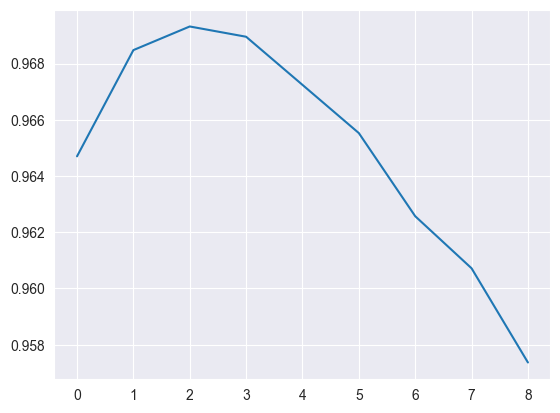

In [ ]:
%matplotlib inline
plt.plot(val_score)

In [ ]:

from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.preprocessing import PolynomialFeatures

### transformation des variables
# modèles

polynomial_features = PolynomialFeatures(degree=3)
X_train_poly = polynomial_features.fit_transform(X_train)
X_test_poly = polynomial_features.fit_transform(X_test)

### entrainement du modèle
linreg = LinearRegression()
linreg.fit(X_train_poly, y_train)
### Evaluation du modèle
y_train_predict = linreg.predict(X_train_poly)
y_test_predict = linreg.predict(X_test_poly)

mse_train = mean_squared_error(y_train, y_train_predict)
rmse_train = (np.sqrt(mse_train))
r2_train = r2_score(y_train, y_train_predict)

mse_test = mean_squared_error(y_test, y_test_predict)
rmse_test = (np.sqrt(mse_test))
r2_test = r2_score(y_test, y_test_predict)

print('La performance du modèle sur la base dapprentissage')
print('--------------------------------------')
print('mse du train {}'.format(mse_train), ' et test {}'.format(mse_test))
print("L'erreur quadratique moyenne du train est {}".format(rmse_train), " et test est {}".format(rmse_test))
print('le score R2 du train est {}'.format(r2_train), ' et test est {}'.format(r2_test))


La performance du modèle sur la base dapprentissage
--------------------------------------
mse du train 3.710532515504142e-18  et test 5.864267826050131e-18
L'erreur quadratique moyenne du train est 1.9262742576030396e-09  et test est 2.4216250382852693e-09
le score R2 du train est 1.0  et test est 1.0


In [ ]:
from sklearn.ensemble import RandomForestRegressor

rf = RandomForestRegressor(max_depth=2, random_state=0)
# Entrainement du modèle
rf.fit(X_train, y_train)
# Evaluation
from sklearn import metrics

print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, rf.predict(X_test)))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, rf.predict(X_test)))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, rf.predict(X_test))))

Mean Absolute Error: 7.029916083490858
Mean Squared Error: 80.67486568944246
Root Mean Squared Error: 8.981918820020724


In [ ]:
from sklearn.tree import DecisionTreeRegressor

dt = DecisionTreeRegressor()
# Entrainement du modèle
dt.fit(X_train, y_train)
# Evaluation
from sklearn import metrics

print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, dt.predict(X_test)))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, dt.predict(X_test)))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, dt.predict(X_test))))

Mean Absolute Error: 0.5034246575342466
Mean Squared Error: 15.886986301369863
Root Mean Squared Error: 3.9858482536807474
